In [ ]:
import albumentations as A
import numpy as np
from albumentations.pytorch import ToTensorV2
from PIL import Image
import torch

import matplotlib.pyplot as plt
%matplotlib inline


In [2]:
model_path = "/tmp/model.ckpt"
# model_path = "/tmp/model_chrome2.ckpt"

# Inference

In [3]:
transform = A.Compose(
    [
        # A.LongestMaxSize(max_size=1024),
        A.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225],
            max_pixel_value=255,
        ),  # [0, 255] -> [0.0, 1.0] normalized
        ToTensorV2(),  # HWC -> CHW
    ],
)


In [4]:
from modules import MRCNNModule

net = MRCNNModule(3)
net.load_from_checkpoint(model_path)
net.eval()


MRCNNModule(
  (model): MaskRCNN(
    (transform): GeneralizedRCNNTransform(
        Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        Resize(min_size=(800,), max_size=1333, mode='bilinear')
    )
    (backbone): BackboneWithFPN(
      (body): IntermediateLayerGetter(
        (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (bn1): FrozenBatchNorm2d(64, eps=0.0)
        (relu): ReLU(inplace=True)
        (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (layer1): Sequential(
          (0): Bottleneck(
            (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (bn1): FrozenBatchNorm2d(64, eps=0.0)
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn2): FrozenBatchNorm2d(64, eps=0.0)
            (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (bn3

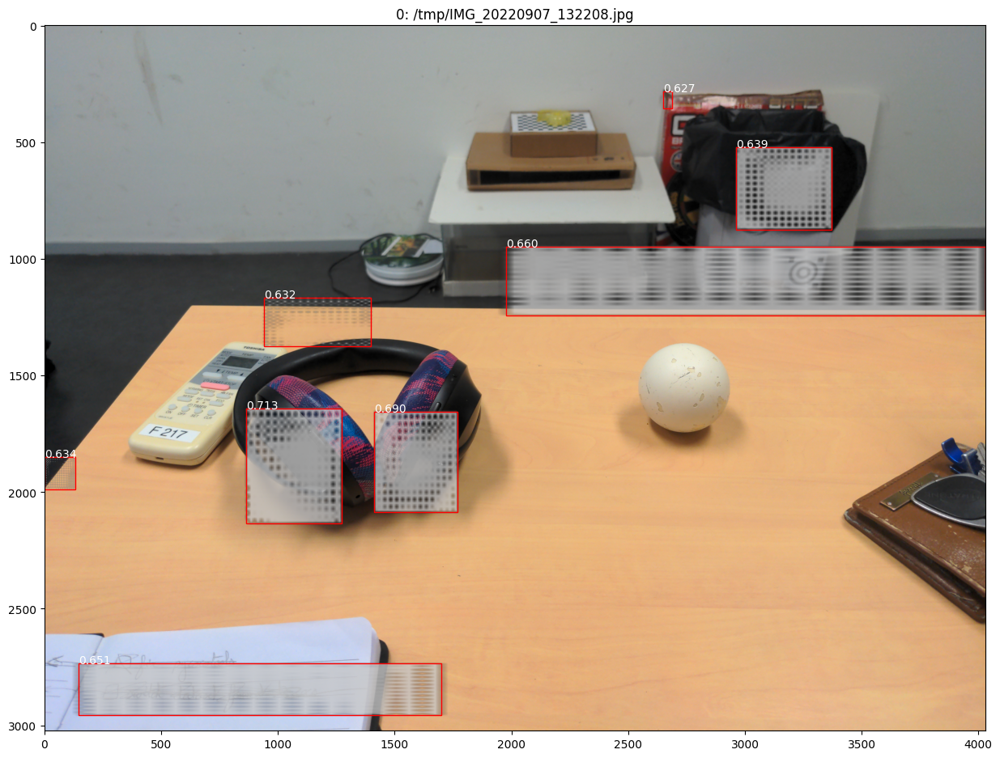

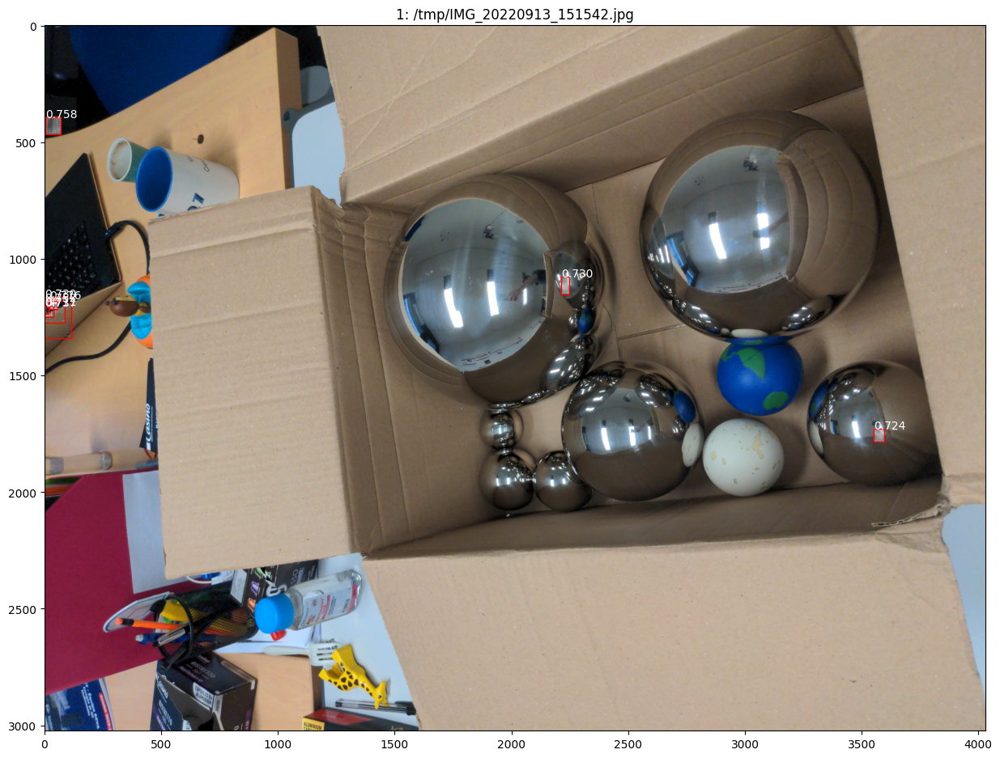

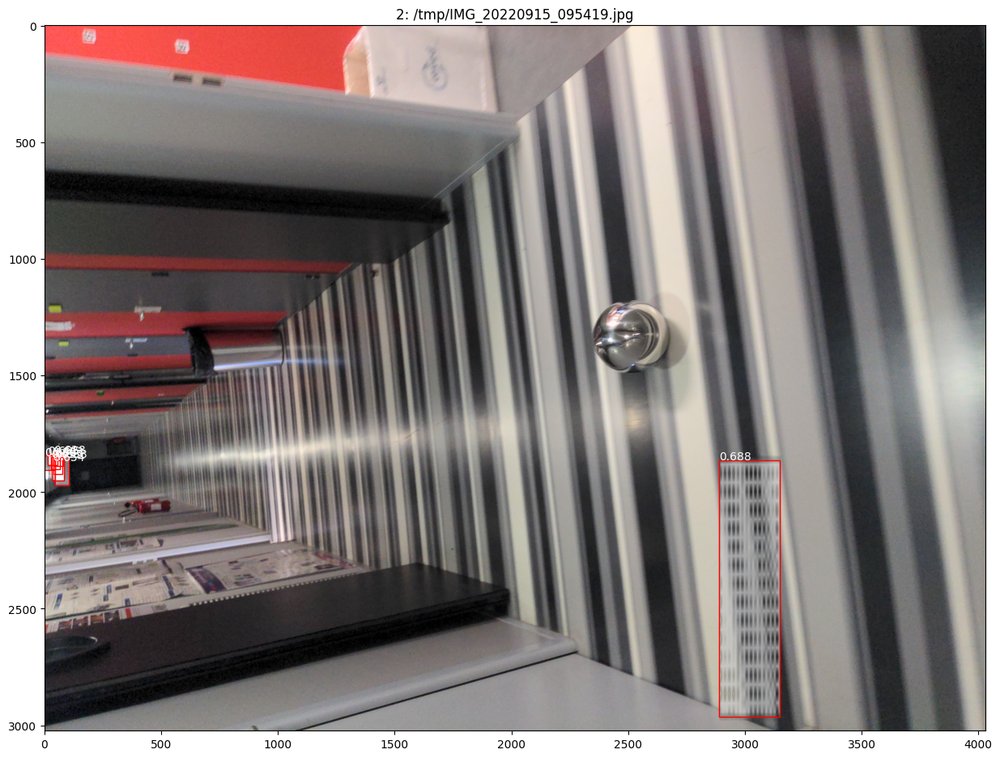

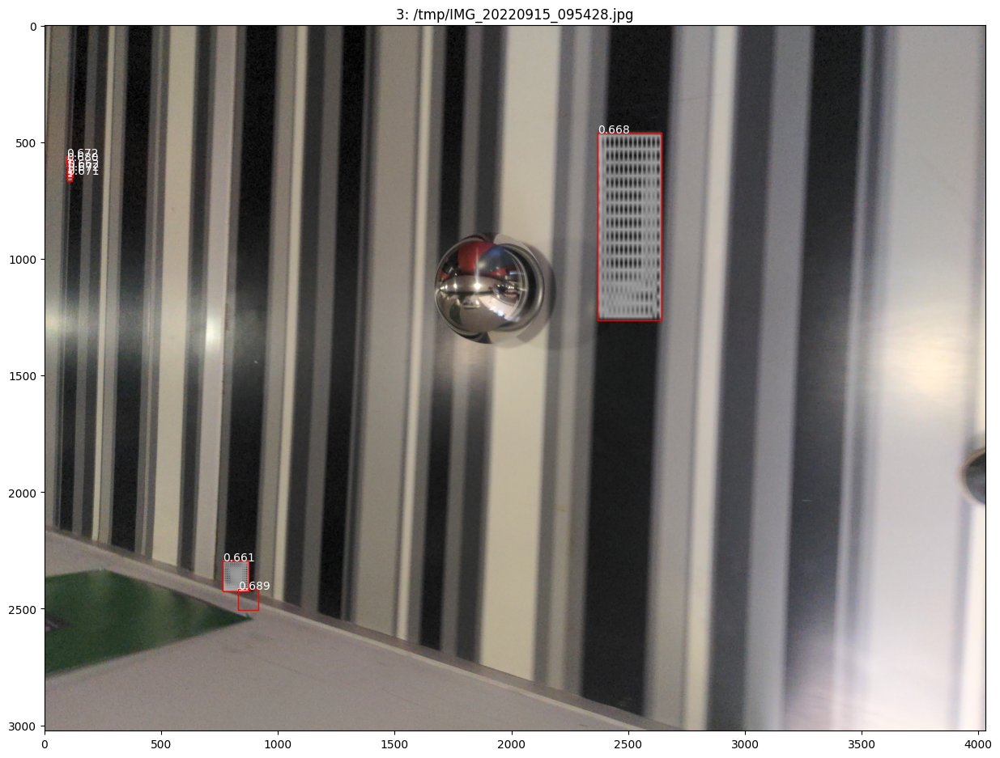

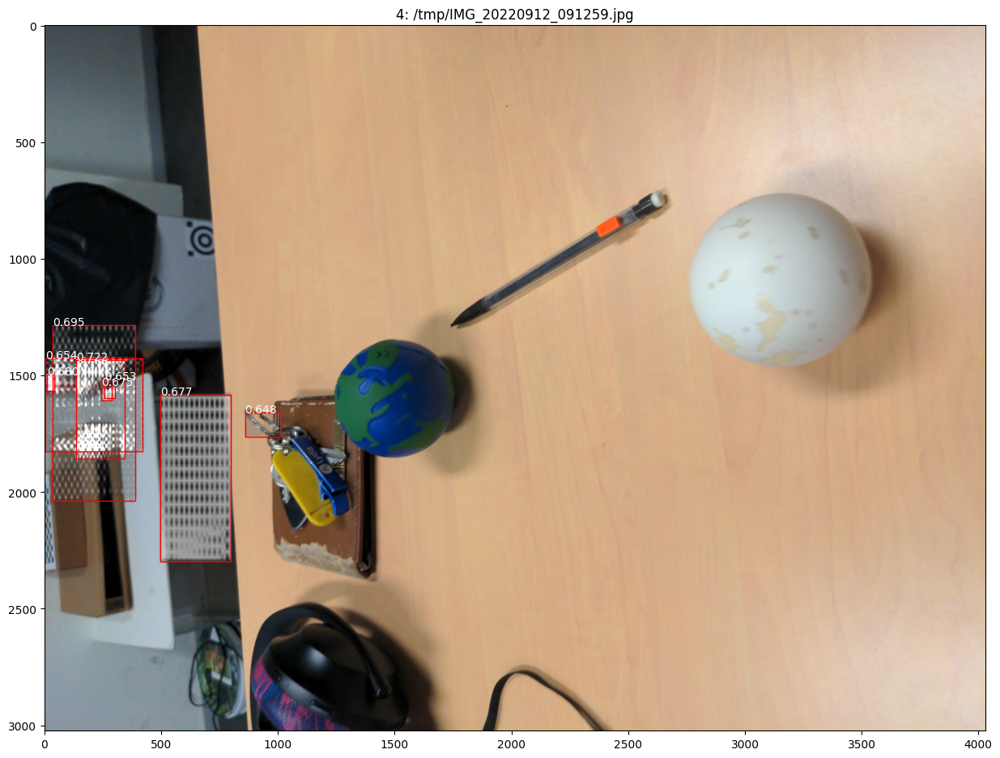

...

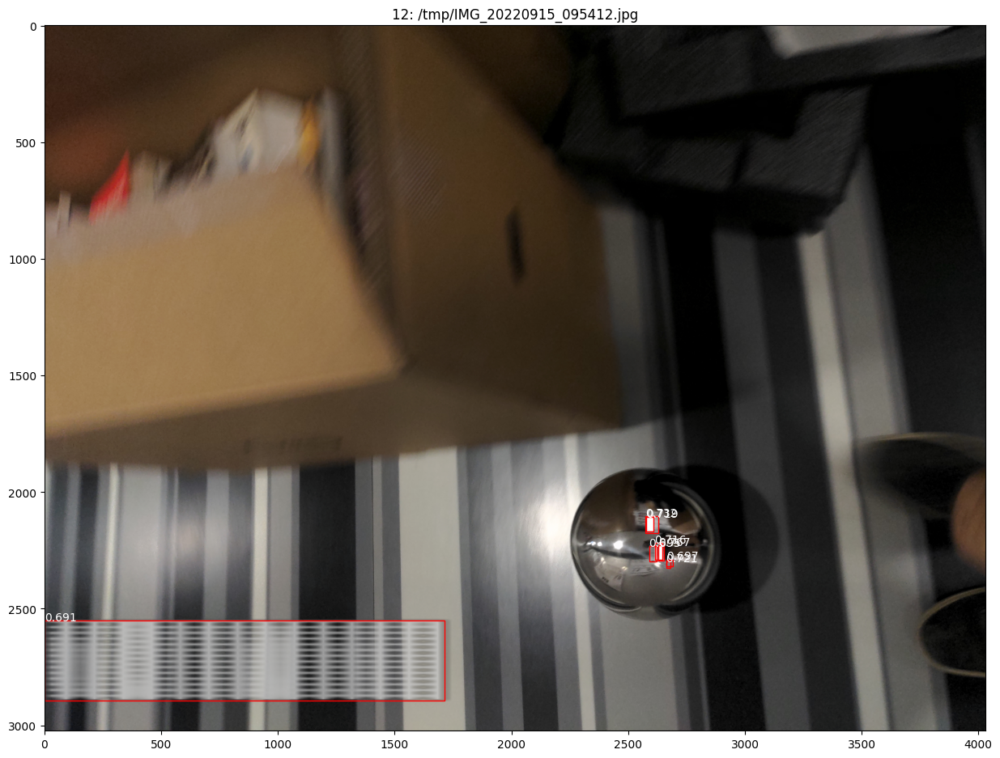

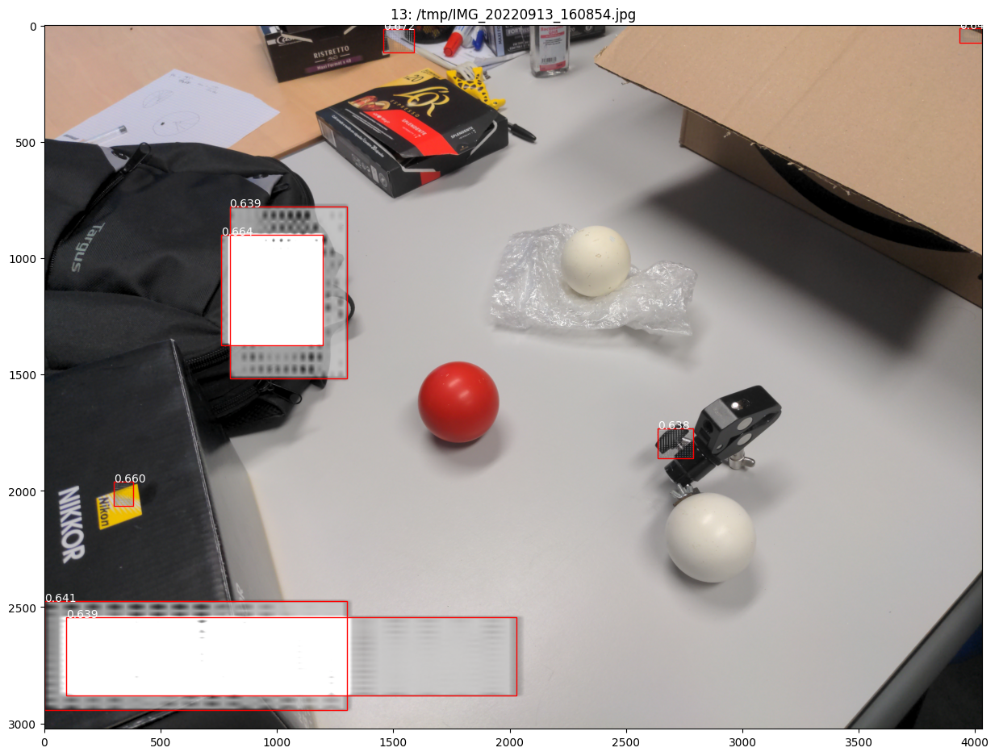

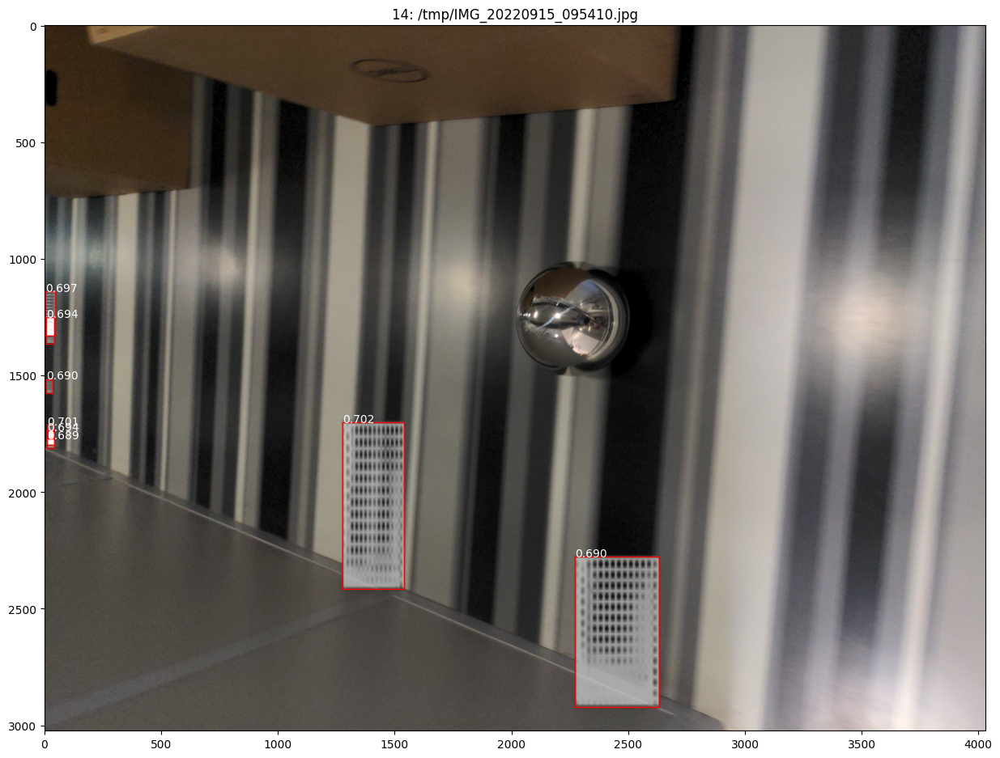

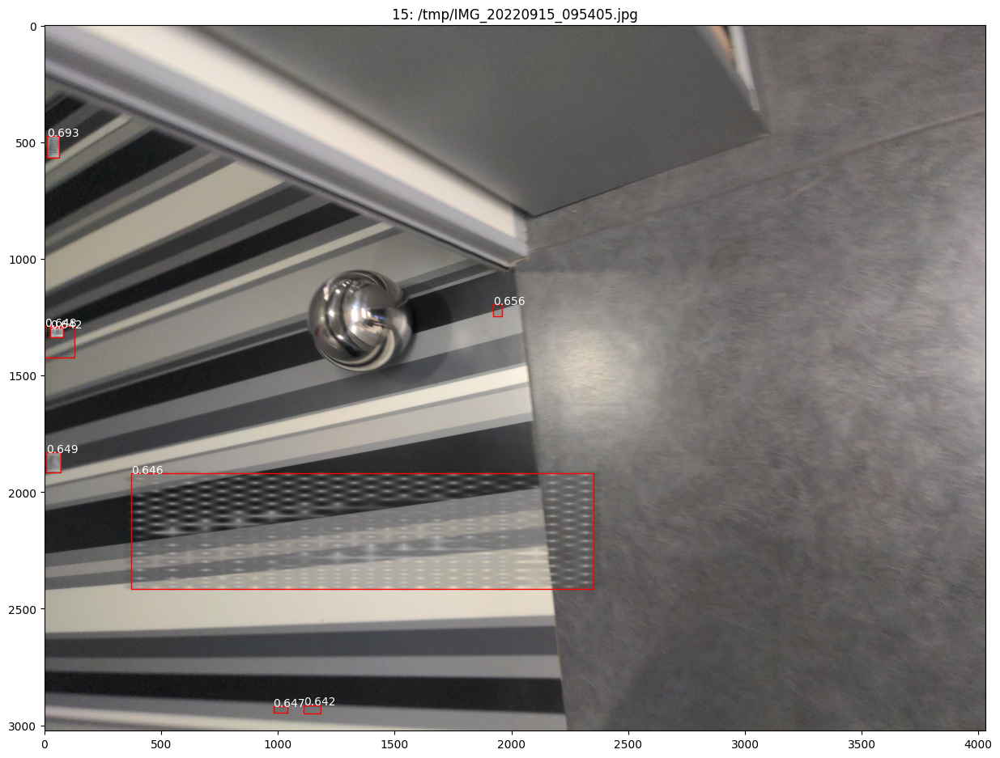

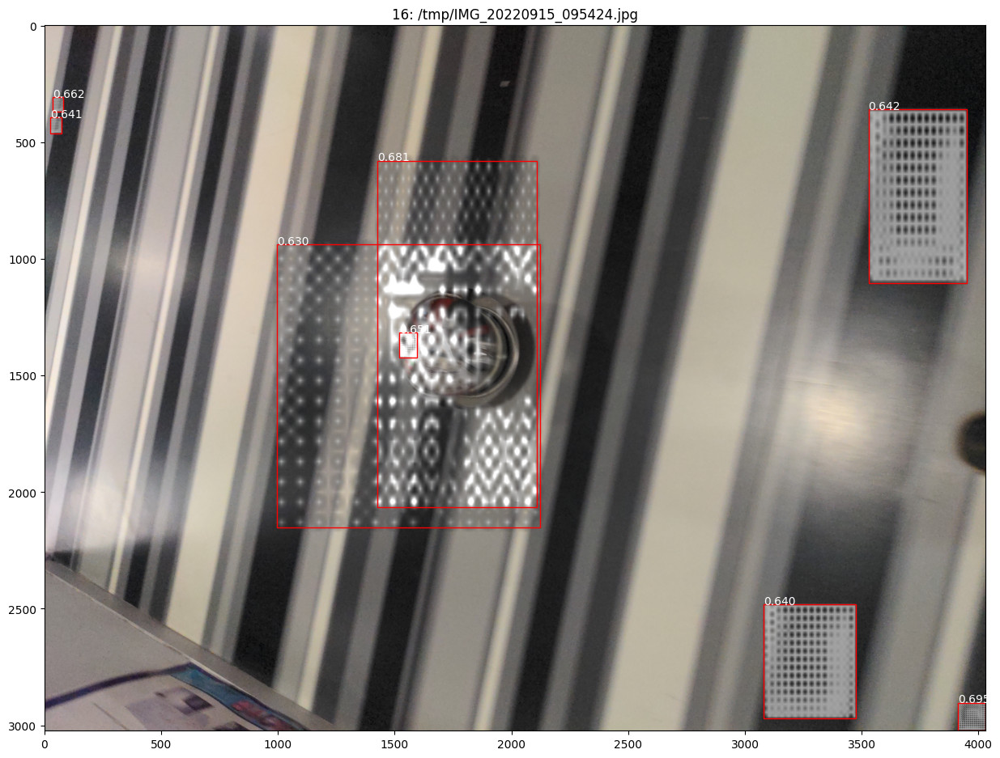

In [5]:
images_path = "/tmp/"
# images_path = "/media/disk1/lfainsin/2022_PARIS1/"

import matplotlib.patches as patches
import pathlib

images_files = list(pathlib.Path(images_path).glob("*.jpg"))

masks = []


for j, image_file in enumerate(images_files):
    spheres = []
    print(j + 1, "/", len(images_files), end="\r")
    image = Image.open(image_file).convert("RGB")

    aug = transform(image=np.asarray(image))
    img = aug["image"]
    img = img.unsqueeze(0)

    outputs = net.model(img)

    n = len(outputs[0]["masks"])
    if n > 0:
        mask = torch.zeros(outputs[0]["masks"][0].shape)
        bboxes = list(outputs[0]["boxes"])
        fig, ax = plt.subplots(1, 1, figsize=(15, 15))

        for i in range(n):

            if outputs[0]["scores"][i] > 0:

                mask += outputs[0]["masks"][i]
                boxe = bboxes[i].detach().numpy()
                rect = patches.Rectangle(
                    (boxe[0], boxe[1]), boxe[2] - boxe[0], boxe[3] - boxe[1], linewidth=1, edgecolor="r", facecolor="none"
                )
                ax.text(boxe[0], boxe[1], f"{outputs[0]['scores'][i]:.03f}", color="white")
                ax.add_patch(rect)

                r = min(boxe[3] - boxe[1], boxe[2] - boxe[0]) / 2
                x = boxe[0] + r - image.width / 2
                y = boxe[0] + r - image.height / 2
                spheres.append({
                    "x": x,
                    "y": y,
                    "r": r,
                })

        plt.title(f"{j}: {image_file}")
        mask = mask.detach().squeeze(0).numpy() * 200
        mask = Image.fromarray(mask).convert("L")
        image.paste(mask, (0, 0), mask)

        plt.subplot(1, 1, 1)
        plt.imshow(image)
